In [ ]:
import tensorflow as tf
import os
import pathlib
import time
import datetime
from matplotlib import pyplot as plt
from IPython import display

30168306/30168306 ━━━━━━━━━━━━━━━━━━━━ 7s 0us/step


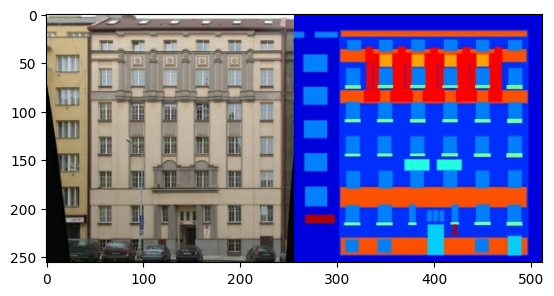

In [ ]:
dataset_name = "facades"
_URL = f'http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/facades.tar.gz'
path_to_zip = tf.keras.utils.get_file(
fname=f"{dataset_name}.tar.gz",
origin=_URL,
extract=True)
path_to_zip = pathlib.Path(path_to_zip)
PATH = path_to_zip.parent/dataset_name
sample_image = tf.io.read_file('/root/.keras/datasets/facades_extracted/facades/test/1.jpg')
sample_image = tf.io.decode_jpeg(sample_image)
plt.figure()
plt.imshow(sample_image)

In [ ]:
def load(image_file):
  image = tf.io.read_file(image_file)
  image = tf.io.decode_jpeg(image)
  w = tf.shape(image)[1]
  w = w // 2
  input_image = image[:, w:, :]
  real_image = image[:, :w, :]
  input_image = tf.cast(input_image, tf.float32)
  real_image = tf.cast(real_image, tf.float32)
  return input_image, real_image

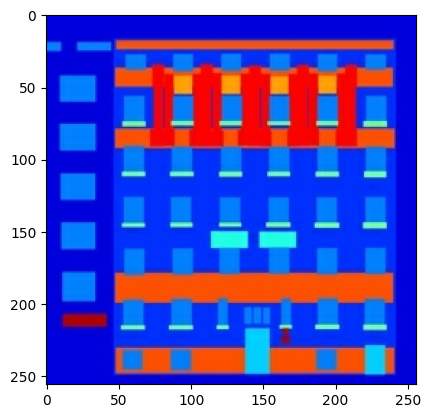

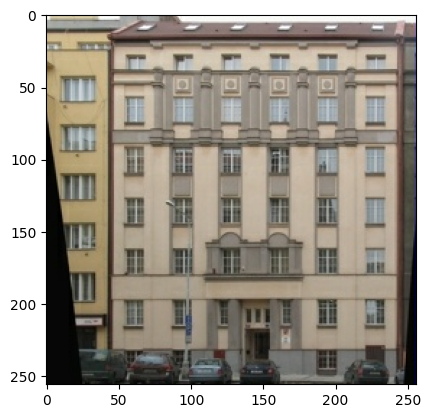

In [ ]:
inp, re = load('/root/.keras/datasets/facades_extracted/facades/test/1.jpg')
plt.figure()
plt.imshow(inp / 255.0)
plt.figure()
plt.imshow(re / 255.0)

In [ ]:
BUFFER_SIZE = 400
BATCH_SIZE = 1
IMG_WIDTH = 256
IMG_HEIGHT = 256

In [ ]:
def resize(input_image, real_image, height, width):
  input_image = tf.image.resize(input_image, [height, width],
  method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  real_image = tf.image.resize(real_image, [height, width],
  method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  return input_image, real_image
def random_crop(input_image, real_image):
  stacked_image = tf.stack([input_image, real_image], axis=0)
  cropped_image = tf.image.random_crop(
  stacked_image, size=[2, IMG_HEIGHT, IMG_WIDTH, 3])
  return cropped_image[0], cropped_image[1]
def normalize(input_image, real_image):
  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1
  return input_image, real_image

In [ ]:
@tf.function()
def random_jitter(input_image, real_image):
  input_image, real_image = resize(input_image, real_image, 286, 286)
  input_image, real_image = random_crop(input_image, real_image)
  if tf.random.uniform(()) > 0.5:
    input_image = tf.image.flip_left_right(input_image)
    real_image = tf.image.flip_left_right(real_image)
  return input_image, real_image

In [ ]:
def load_image_train(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = random_jitter(input_image, real_image)
  input_image, real_image = normalize(input_image, real_image)
  return input_image, real_image
def load_image_test(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = resize(input_image, real_image,
  IMG_HEIGHT, IMG_WIDTH)
  input_image, real_image = normalize(input_image, real_image)
  return input_image, real_image

In [ ]:
train_dataset = tf.data.Dataset.list_files(str('/root/.keras/datasets/facades_extracted/facades/train/*.jpg'))
train_dataset = train_dataset.map(load_image_train,
num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)
test_dataset = tf.data.Dataset.list_files(str('/root/.keras/datasets/facades_extracted/facades/val/*.jpg'))
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(BATCH_SIZE)

In [ ]:
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)
  result = tf.keras.Sequential()
  result.add(
  tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
  kernel_initializer=initializer,
  use_bias=False))
  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())
  result.add(tf.keras.layers.LeakyReLU())
  return result
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)
  result = tf.keras.Sequential()
  result.add(
  tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
  padding='same',
  kernel_initializer=initializer,
  use_bias=False))
  result.add(tf.keras.layers.BatchNormalization())
  if apply_dropout:
    result.add(tf.keras.layers.Dropout(0.5))
  result.add(tf.keras.layers.ReLU())
  return result

In [ ]:
down_model = downsample(3, 4)
down_result = down_model(tf.expand_dims(inp, 0))
print (down_result.shape)
up_model = upsample(3, 4)
up_result = up_model(down_result)
print (up_result.shape)

(1, 128, 128, 3)
(1, 256, 256, 3)


In [ ]:
OUTPUT_CHANNELS = 3
def Generator():
  inputs = tf.keras.layers.Input(shape=[256, 256, 3])
  down_stack = [
    downsample(64, 4, apply_batchnorm=False), # (batch_size, 128, 128, 64)
    downsample(128, 4), # (batch_size, 64, 64, 128)
    downsample(256, 4), # (batch_size, 32, 32, 256)
    downsample(512, 4), # (batch_size, 16, 16, 512)
    downsample(512, 4), # (batch_size, 8, 8, 512)
    downsample(512, 4), # (batch_size, 4, 4, 512)
    downsample(512, 4), # (batch_size, 2, 2, 512)
    downsample(512, 4), # (batch_size, 1, 1, 512)
  ]
  up_stack = [
    upsample(512, 4, apply_dropout=True), # (batch_size, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True), # (batch_size, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True), # (batch_size, 8, 8, 1024)
    upsample(512, 4), # (batch_size, 16, 16, 1024)
    upsample(256, 4), # (batch_size, 32, 32, 512)
    upsample(128, 4), # (batch_size, 64, 64, 256)
    upsample(64, 4), # (batch_size, 128, 128, 128)
  ]
  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
  strides=2,
  padding='same',
  kernel_initializer=initializer,
  activation='tanh')
  x = inputs
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)
  skips = reversed(skips[:-1])
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])
  x = last(x)
  return tf.keras.Model(inputs=inputs, outputs=x)

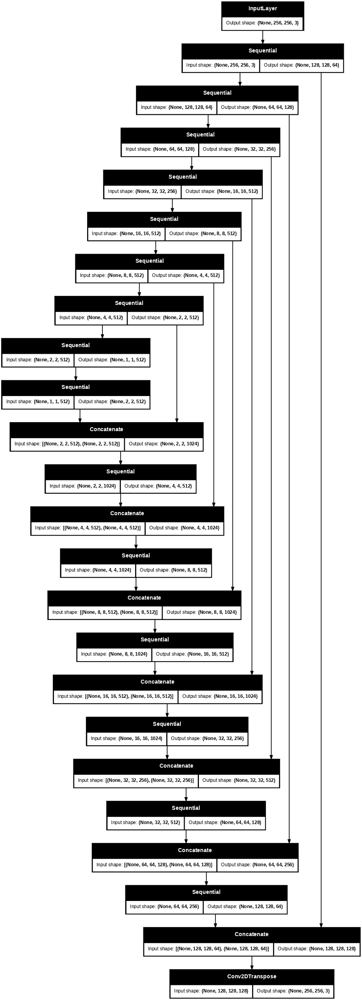

In [ ]:
generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

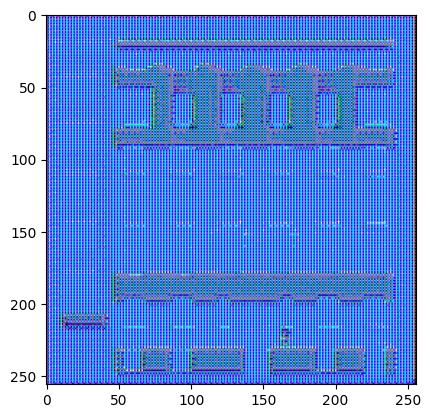

In [ ]:
gen_output = generator(inp[tf.newaxis, ...], training=False)
plt.imshow(gen_output[0, ...])

In [ ]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)
  inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')
  x = tf.keras.layers.concatenate([inp, tar])
  down1 = downsample(64, 4, False)(x) # (batch_size, 128, 128, 64)
  down2 = downsample(128, 4)(down1) # (batch_size, 64, 64, 128)
  down3 = downsample(256, 4)(down2) # (batch_size, 32, 32, 256)
  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
  kernel_initializer=initializer,
  use_bias=False)(zero_pad1)
  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)
  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)
  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)
  last = tf.keras.layers.Conv2D(1, 4, strides=1,
  kernel_initializer=initializer)(zero_pad2)
  return tf.keras.Model(inputs=[inp, tar], outputs=last)

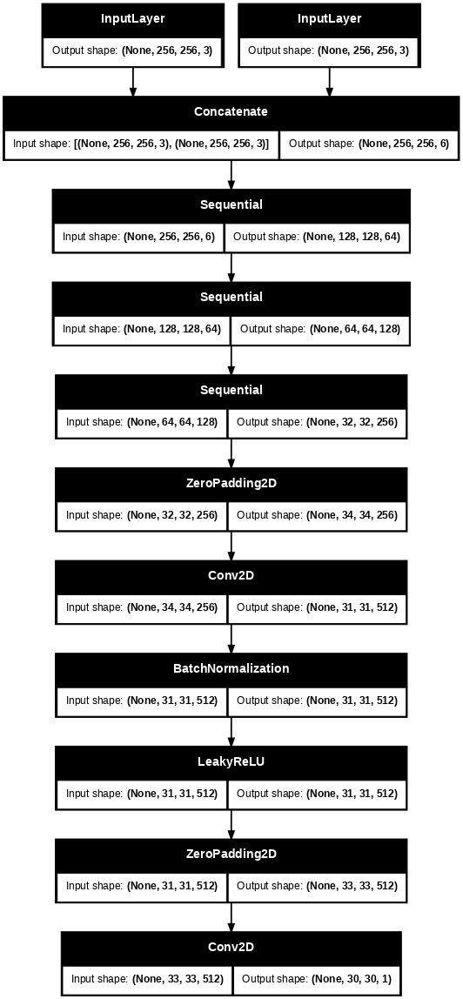

In [ ]:
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

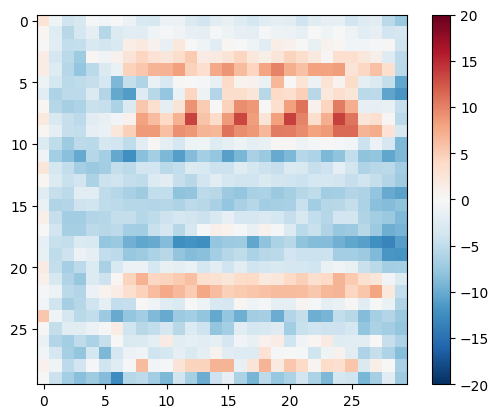

In [ ]:
disc_out = discriminator([inp[tf.newaxis, ...], gen_output], training=False)
plt.imshow(disc_out[0, ..., -1], vmin=-20, vmax=20, cmap='RdBu_r')
plt.colorbar()

In [ ]:
LAMBDA = 100 # выбрано в pix2pix
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output),
  disc_generated_output)
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
  total_gen_loss = gan_loss + (LAMBDA * l1_loss)
  return total_gen_loss, gan_loss, l1_loss

In [ ]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output),
  disc_real_output)
  generated_loss = loss_object(tf.zeros_like(disc_generated_output),
  disc_generated_output)
  total_disc_loss = real_loss + generated_loss
  return total_disc_loss

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
discriminator_optimizer=discriminator_optimizer,
generator=generator,
discriminator=discriminator)

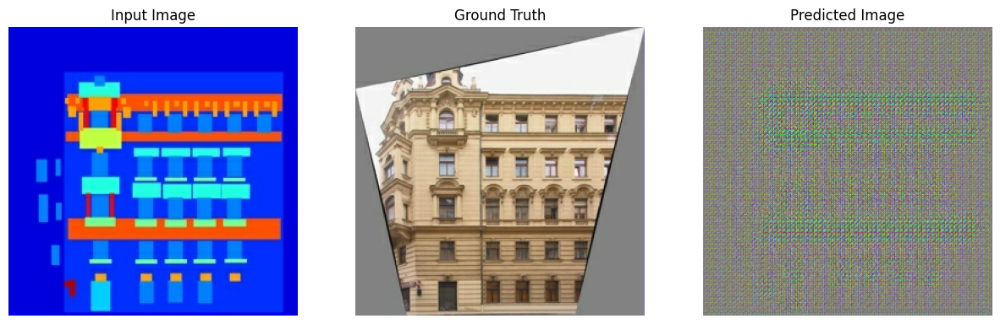

In [ ]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))
  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']
  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

for example_input, example_target in test_dataset.take(1):
  generate_images(generator, example_input, example_target)

In [ ]:
log_dir="logs/"
summary_writer = tf.summary.create_file_writer(
log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [ ]:
@tf.function
def train_step(input_image, target, step, val_input_image=None, val_target=None):
    # Обучение на тренировочных данных
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = generator(input_image, training=True)
        disc_real_output = discriminator([input_image, target], training=True)
        disc_generated_output = discriminator([input_image, gen_output], training=True)
        gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
        disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

    # Обновление весов
    generator_gradients = gen_tape.gradient(gen_total_loss, generator.trainable_variables)
    discriminator_gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    generator_optimizer.apply_gradients(zip(generator_gradients, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(discriminator_gradients, discriminator.trainable_variables))

    # Логирование тренировочных потерь
    with summary_writer.as_default():
        tf.summary.scalar('gen_total_loss', gen_total_loss, step=step)
        tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=step)
        tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=step)
        tf.summary.scalar('disc_loss', disc_loss, step=step)

    # Логирование валидационных потерь (если переданы валидационные данные)
    if val_input_image is not None and val_target is not None:
        val_gen_output = generator(val_input_image, training=False)  # Отключаем обучение для валидации
        val_disc_real_output = discriminator([val_input_image, val_target], training=False)
        val_disc_generated_output = discriminator([val_input_image, val_gen_output], training=False)
        val_gen_total_loss, val_gen_gan_loss, val_gen_l1_loss = generator_loss(
            val_disc_generated_output, val_gen_output, val_target
        )
        val_disc_loss = discriminator_loss(val_disc_real_output, val_disc_generated_output)

        # Логирование валидационных потерь
        with summary_writer.as_default():
            tf.summary.scalar('val_gen_total_loss', val_gen_total_loss, step=step)
            tf.summary.scalar('val_gen_gan_loss', val_gen_gan_loss, step=step)
            tf.summary.scalar('val_gen_l1_loss', val_gen_l1_loss, step=step)
            tf.summary.scalar('val_disc_loss', val_disc_loss, step=step)

In [ ]:
def fit(train_ds, test_ds, steps):
    example_input, example_target = next(iter(test_ds.take(1)))
    start = time.time()
    for step, (input_image, target) in train_ds.repeat().take(steps).enumerate():
        # Получаем валидационные данные
        val_input_image, val_target = next(iter(test_ds.take(1)))

        # Вызов train_step с валидационными данными
        train_step(input_image, target, step, val_input_image, val_target)

        if (step) % 100 == 0:
            display.clear_output(wait=True)
            if step != 0:
                print(f'Time taken for 100 steps: {time.time()-start:.2f} sec\n')
            start = time.time()
            generate_images(generator, example_input, example_target)
            print(f"Step: {step}")

        if (step + 1) % 10 == 0:
            print('.', end='', flush=True)
        if (step + 1) % 100 == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

Time taken for 100 steps: 20.57 sec



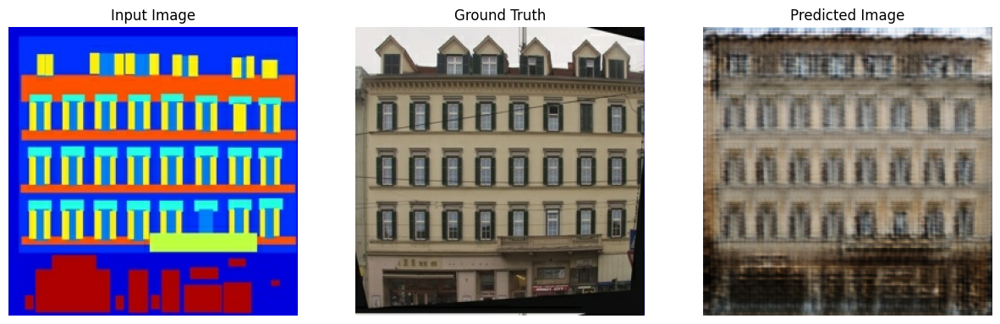

Step: 7900
..........

In [ ]:
%load_ext tensorboard
%tensorboard --logdir {log_dir}
fit(train_dataset, test_dataset, steps=8000)

In [ ]:
%load_ext tensorboard
%tensorboard --logdir=logs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
import pandas as pd

# Путь к логам
log_dir = "/content/logs/fit/20250316-184902/events.out.tfevents.1742150942.75e93e156e07.179.0.v2"

# Загрузка данных из логов
log_data = []
for event in tf.compat.v1.train.summary_iterator(log_dir):
    for value in event.summary.value:
        if value.tag == 'gen_l1_loss':
            log_data.append({
                'step': event.step,
                'gen_l1_loss': tf.make_ndarray(value.tensor)
            })

# Поиск точки с минимальной gen_total_loss/
df = pd.DataFrame(log_data)
optimal_step = df.loc[df['gen_l1_loss'].idxmin()]['step']
print(f'Оптимальный шаг: {optimal_step}')

Оптимальный шаг: 6151


In [ ]:
generator = Generator()
discriminator = Discriminator()

checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(
    generator_optimizer=generator_optimizer,
    discriminator_optimizer=discriminator_optimizer,
    generator=generator,
    discriminator=discriminator
)

latest_checkpoint = tf.train.latest_checkpoint(checkpoint_dir)
if latest_checkpoint:
    print(f"Загружаем чекпоинт: {latest_checkpoint}")
    checkpoint.restore(latest_checkpoint).expect_partial()
else:
    print("Чекпоинты не найдены.")

Загружаем чекпоинт: ./training_checkpoints/ckpt-80


In [ ]:
best_generator = Generator()
best_discriminator = Discriminator()

checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(
    generator_optimizer=generator_optimizer,
    discriminator_optimizer=discriminator_optimizer,
    generator=best_generator,
    discriminator=best_discriminator
)

# Загрузка чекпоинта для шага 6151
checkpoint_path = f"{checkpoint_prefix}-2"
checkpoint.restore(checkpoint_path).expect_partial()
print(f"Загружен чекпоинт для шага 6151: {checkpoint_path}")

Загружен чекпоинт для шага 7: ./training_checkpoints/ckpt-2


In [ ]:
# Сохранение весов генератора и дискриминатора
best_generator.save_weights('best_generator.weights.h5')
best_discriminator.save_weights('best_discriminator.weights.h5')

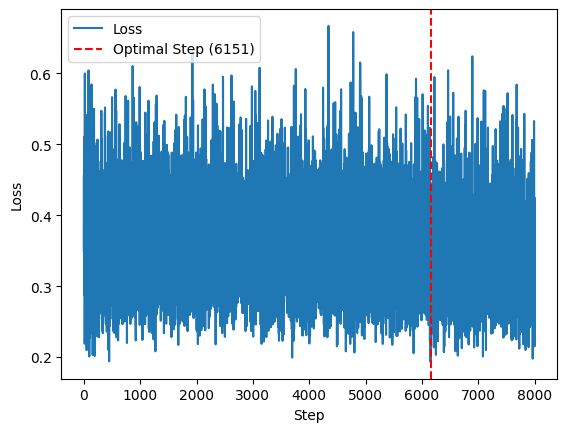

In [ ]:
plt.plot(df['step'], df['gen_l1_loss'], label='Loss')
plt.axvline(x=optimal_step, color='r', linestyle='--', label=f'Optimal Step ({optimal_step})')
plt.xlabel('Step')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
import tensorflow as tf
import tensorflow_datasets as tfds
import numpy as np
import matplotlib.pyplot as plt
import os

# --- Глобальные параметры ---
IMG_SIZE = 128
BATCH_SIZE = 16
LATENT_DIM = 128
BUFFER_SIZE = 1000
EPOCHS = 50

# --- Директории ---
LOG_DIR = "logs/"
CHECKPOINT_DIR = "checkpoints/"
BEST_MODEL_DIR = "best_model/"
os.makedirs(LOG_DIR, exist_ok=True)
os.makedirs(CHECKPOINT_DIR, exist_ok=True)
os.makedirs(BEST_MODEL_DIR, exist_ok=True)

dataset_name = "oxford_iiit_pet:4.0.0"
data_source = tfds.data_source(dataset_name)

data = data_source["train"]

# Преобразуем ArrayRecordDataSource в tf.data.Dataset
def to_tf_dataset(data_source):
    def generator():
        for sample in data_source:
            # Возвращаем только нужные ключи
            yield {
                "image": sample["image"],
                "segmentation_mask": sample["segmentation_mask"]
            }
    return tf.data.Dataset.from_generator(generator, output_signature={
        "image": tf.TensorSpec(shape=(None, None, 3), dtype=tf.uint8),
        "segmentation_mask": tf.TensorSpec(shape=(None, None, 1), dtype=tf.uint8),
    })

# Преобразуем данные в tf.data.Dataset
train_data = to_tf_dataset(data)

def preprocess(sample):
    image = tf.image.resize(sample["image"], (128, 128)) / 255.0
    mask = tf.image.resize(sample["segmentation_mask"], (128, 128))
    mask = tf.cast(mask, tf.float32) / 255.0
    return mask, image

train_dataset = train_data.map(preprocess).shuffle(1000).batch(16)

# --- Блоки нейросети ---
def conv_block(x, filters, kernel_size=3, strides=1, activation=True):
    x = tf.keras.layers.Conv2D(filters, kernel_size, strides=strides, padding="same", use_bias=False)(x)
    x = tf.keras.layers.BatchNormalization()(x)
    if activation:
        x = tf.keras.layers.LeakyReLU(0.2)(x)
    return x

def residual_block(x, filters):
    res = conv_block(x, filters)
    res = conv_block(res, filters, activation=False)
    return tf.keras.layers.Add()([x, res])

def upsample_block(x, filters):
    x = tf.keras.layers.Conv2DTranspose(filters, 4, strides=2, padding="same", use_bias=False)(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.LeakyReLU(0.2)(x)
    return x

def build_generator():
    inputs_mask = tf.keras.layers.Input(shape=(IMG_SIZE, IMG_SIZE, 1))
    noise = tf.keras.layers.Input(shape=(LATENT_DIM,))

    # Вектор шума → плотный слой
    x = tf.keras.layers.Dense(8 * 8 * 256, activation="relu")(noise)
    x = tf.keras.layers.Reshape((8, 8, 256))(x)

    # Encoder (маска)
    mask_enc = conv_block(inputs_mask, 64)
    mask_enc = conv_block(mask_enc, 128, strides=2)
    mask_enc = conv_block(mask_enc, 256, strides=2)  # Форма (32, 32, 256)

    # Увеличиваем размерность x до (32, 32, 256)
    x = tf.keras.layers.Conv2DTranspose(256, kernel_size=4, strides=4, padding="same")(x)

    # Сложение тензоров
    x = tf.keras.layers.Add()([x, mask_enc])

    # Bottleneck
    for _ in range(3):
        x = residual_block(x, 256)

    # Decoder (только два блока апсемплинга)
    x = upsample_block(x, 128)  # 64x64
    x = upsample_block(x, 64)   # 128x128

    # Выходное изображение
    output = tf.keras.layers.Conv2D(3, 7, activation="sigmoid", padding="same")(x)
    return tf.keras.Model([inputs_mask, noise], output)

def build_discriminator():
    inputs_mask = tf.keras.layers.Input(shape=(128, 128, 1))  # Размер маски 128x128
    inputs_image = tf.keras.layers.Input(shape=(128, 128, 3))  # Размер изображения 128x128

    # Объединение масок и изображений
    x = tf.keras.layers.Concatenate()([inputs_mask, inputs_image])

    # Архитектура
    x = conv_block(x, 64)
    x = conv_block(x, 128, strides=2)
    x = conv_block(x, 256, strides=2)
    x = conv_block(x, 512, strides=2)

    x = tf.keras.layers.GlobalAveragePooling2D()(x)
    output = tf.keras.layers.Dense(1)(x)

    return tf.keras.Model([inputs_mask, inputs_image], output)

# --- Оптимизаторы ---
generator = build_generator()
discriminator = build_discriminator()
gen_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5, beta_2=0.9)
disc_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5, beta_2=0.9)

def discriminator_loss(real_output, fake_output):
    return tf.reduce_mean(fake_output) - tf.reduce_mean(real_output)

def generator_loss(fake_output):
    return -tf.reduce_mean(fake_output)

vgg = tf.keras.applications.VGG19(include_top=False, weights="imagenet")
vgg.trainable = False
feature_extractor = tf.keras.Model(vgg.input, vgg.layers[8].output)

def perceptual_loss(real_images, fake_images):
    real_features = feature_extractor(real_images)
    fake_features = feature_extractor(fake_images)
    return tf.reduce_mean(tf.abs(real_features - fake_features))

def gradient_penalty(discriminator, real_images, fake_images, mask):
    batch_size = tf.shape(real_images)[0]
    alpha = tf.random.uniform([batch_size, 1, 1, 1], 0.0, 1.0)
    interpolated = alpha * real_images + (1 - alpha) * fake_images
    with tf.GradientTape() as tape:
        tape.watch(interpolated)
        pred = discriminator([mask, interpolated])
    grads = tape.gradient(pred, [interpolated])[0]
    norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1, 2, 3]) + 1e-10)
    return tf.reduce_mean(tf.square(norm - 1.0))

generator = build_generator()
discriminator = build_discriminator()

# --- Оптимизаторы ---
gen_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5, beta_2=0.9)
disc_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5, beta_2=0.9)

# --- TensorBoard ---
summary_writer = tf.summary.create_file_writer(LOG_DIR)

# --- Функция обучения ---
best_gen_loss = float("inf")

@tf.function
def train_step(mask, real_images):
    batch_size = tf.shape(mask)[0]
    noise = tf.random.normal([batch_size, LATENT_DIM])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        fake_images = generator([mask, noise], training=True)

        real_output = discriminator([mask, real_images], training=True)
        fake_output = discriminator([mask, fake_images], training=True)

        gp = gradient_penalty(discriminator, real_images, fake_images, mask)
        disc_loss = discriminator_loss(real_output, fake_output) + 10 * gp
        gen_loss = generator_loss(fake_output) + 0.1 * perceptual_loss(real_images, fake_images)

    gradients_gen = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_disc = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    gen_optimizer.apply_gradients(zip(gradients_gen, generator.trainable_variables))
    disc_optimizer.apply_gradients(zip(gradients_disc, discriminator.trainable_variables))

    return gen_loss, disc_loss

In [ ]:
# --- Цикл обучения ---
for epoch in range(EPOCHS):
    gen_loss_total, disc_loss_total = 0, 0
    num_batches = 0

    for mask_batch, real_batch in train_dataset:
        gen_loss, disc_loss = train_step(mask_batch, real_batch)
        gen_loss_total += gen_loss.numpy()
        disc_loss_total += disc_loss.numpy()
        num_batches += 1

    gen_loss_avg = gen_loss_total / num_batches
    disc_loss_avg = disc_loss_total / num_batches

    print(f"Epoch {epoch+1}/{EPOCHS} | Gen Loss: {gen_loss_avg:.4f} | Disc Loss: {disc_loss_avg:.4f}")

    # --- Логирование в TensorBoard ---
    with summary_writer.as_default():
        tf.summary.scalar("Generator Loss", gen_loss_avg, step=epoch)
        tf.summary.scalar("Discriminator Loss", disc_loss_avg, step=epoch)

    # --- Сохранение лучших весов генератора ---
    if gen_loss_avg < best_gen_loss:
        best_gen_loss = gen_loss_avg
        generator.save_weights(BEST_MODEL_DIR + "best_generator.weights.h5")
        print(f"New best generator saved at epoch {epoch+1}!")

    # --- Сохранение чекпоинтов каждые 10 эпох ---
    if (epoch + 1) % 10 == 0:
        generator.save_weights(CHECKPOINT_DIR + f"generator_epoch_{epoch+1}.weights.h5")
        discriminator.save_weights(CHECKPOINT_DIR + f"discriminator_epoch_{epoch+1}.weights.h5")
        print(f"Checkpoint saved at epoch {epoch+1}")

    # --- Визуализация в конце каждой эпохи ---
    sample_mask, sample_real = next(iter(train_dataset))  # Берём один батч данных
    sample_noise = tf.random.normal([sample_mask.shape[0], LATENT_DIM])  # Шум для генерации
    generated_images = generator([sample_mask, sample_noise], training=False)  # Генерация изображений

    # Отображаем первые 5 примеров
    num_samples = min(5, sample_mask.shape[0])
    fig, axes = plt.subplots(3, num_samples, figsize=(15, 6))

    for i in range(num_samples):
        # Маска
        axes[0, i].imshow(tf.squeeze(sample_mask[i]), cmap="gray")
        axes[0, i].axis("off")
        axes[0, i].set_title("Mask")

        # Оригинальное изображение
        axes[1, i].imshow(sample_real[i])
        axes[1, i].axis("off")
        axes[1, i].set_title("Real Image")

        # Сгенерированное изображение
        axes[2, i].imshow(generated_images[i])
        axes[2, i].axis("off")
        axes[2, i].set_title("Generated Image")

    plt.tight_layout()
    #plt.savefig(LOG_DIR + f"epoch_{epoch+1}_visualization.png")
    plt.show()